In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/data_object_image_2.zip -d /content/drive/MyDrive/kitti_data


In [ ]:
!unzip /content/drive/MyDrive/kitti_data/Label.zip -d /content/drive/MyDrive/kitti_data/data_object_image_2


In [ ]:
# Ultralytics, tqdm, and ONNX-related libraries
!pip install -q ultralytics tqdm onnx onnxruntime onnxruntime-tools

# Torch with GPU support (cu118)
!pip install -q torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118

# Pruning and NVIDIA-related tools
!pip install -q torch-pruning nvidia-ml-py3 nvidia-pyindex nvidia-tensorrt pycuda


In [ ]:
# Core Libraries
import os
import time
import json
import shutil
import subprocess
from pathlib import Path

# Numerical & Data Processing
import numpy as np
import pandas as pd

# Visualization
import matplotlib.pyplot as plt
from PIL import Image
import torchvision.transforms as T

# Progress Bar
from tqdm import tqdm, auto as tqdm_auto

# Machine Learning
from sklearn.model_selection import train_test_split

# Deep Learning and Model Handling
import torch
import torch.nn.utils.prune as prune
import torch_pruning as tp
from ultralytics import YOLO

# ONNX Runtime and Quantization
import onnxruntime as ort
from onnxruntime.quantization import quantize_dynamic, QuantType
from tqdm import tqdm

In [ ]:
base_dir = Path('/content/drive/MyDrive/kitti_data')
img_path = base_dir / 'data_object_image_2' / 'training' / 'image_2'
label_path = Path('/content/drive/MyDrive/kitti_data/data_object_image_2/Label/labels')
with open('/content/drive/MyDrive/kitti_data/data_object_image_2/Label/classes.json','r') as f:
    classes = json.load(f)

classes

{'Car': 0,
 'Pedestrian': 1,
 'Van': 2,
 'Cyclist': 3,
 'Truck': 4,
 'Misc': 5,
 'Tram': 6,
 'Person_sitting': 7}

In [ ]:
ims = sorted(list(img_path.glob('*')))
labels = sorted(list(label_path.glob('*')))
pairs = list(zip(ims,labels))
pairs[5300:5302]

[(PosixPath('/content/drive/MyDrive/kitti_data/data_object_image_2/training/image_2/005300.png'),
  PosixPath('/content/drive/MyDrive/kitti_data/data_object_image_2/Label/labels/005300.txt')),
 (PosixPath('/content/drive/MyDrive/kitti_data/data_object_image_2/training/image_2/005301.png'),
  PosixPath('/content/drive/MyDrive/kitti_data/data_object_image_2/Label/labels/005301.txt'))]

In [ ]:
#!unzip /content/drive/MyDrive/kitti_data/data_object_image_2/training/image_2.zip -d /content/drive/MyDrive/kitti_data/data_object_image_2/training

In [ ]:
train, test = train_test_split(pairs,test_size=0.1,shuffle=True)
len(train), len(test)

(6732, 749)

In [ ]:
train_path = Path('/content/drive/MyDrive/kitti_data/data_object_image_2/train').resolve()
train_path.mkdir(exist_ok=True)
valid_path = Path('/content/drive/MyDrive/kitti_data/data_object_image_2/valid').resolve()
valid_path.mkdir(exist_ok=True)

In [ ]:
for t_img, t_lb in tqdm(train):
    im_path = train_path / t_img.name
    lb_path = train_path / t_lb.name
    shutil.copy(t_img,im_path)
    shutil.copy(t_lb,lb_path)

  0%|          | 0/6732 [00:00<?, ?it/s]

In [ ]:
for t_img, t_lb in tqdm(test):
    im_path = valid_path / t_img.name
    lb_path = valid_path / t_lb.name
    shutil.copy(t_img,im_path)
    shutil.copy(t_lb,lb_path)

  0%|          | 0/749 [00:00<?, ?it/s]

In [ ]:
yaml_file = 'names:\n'
yaml_file += '\n'.join(f'- {c}' for c in classes)
yaml_file += f'\nnc: {len(classes)}'
yaml_file += f'\ntrain: {str(train_path)}\nval: {str(valid_path)}'
# Set the output path inside your Drive
yaml_save_path = '/content/drive/MyDrive/kitti.yaml'

# Write to Drive
with open(yaml_save_path, 'w') as f:
    f.write(yaml_file)

print(f"YAML file saved to: {yaml_save_path}")


YAML file saved to: /content/drive/MyDrive/kitti.yaml


In [ ]:
!cat kitti.yaml

names:
- Car
- Pedestrian
- Van
- Cyclist
- Truck
- Misc
- Tram
- Person_sitting
nc: 8
train: /content/train
val: /content/valid

In [ ]:
model = YOLO('yolov8n.yaml')
model = YOLO('yolov8n.pt')

In [ ]:
train_results = model.train(
    data='/content/drive/MyDrive/kitti.yaml',
    epochs=15,
    patience=3,
    mixup=0.1,
    project='/content/drive/MyDrive/kitti_data/yolov8n-kitti',
    name='exp',
    device=0
)

Ultralytics 8.3.165 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/kitti.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=15, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.1, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=exp, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=3, perspective=0.0, plots=True, pose=12.0,

train: Scanning /content/train.cache... 6732 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6732/6732 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3268.1±2122.9 MB/s, size: 855.5 KB)


val: Scanning /content/valid.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000833, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/kitti_data/yolov8n-kitti/exp
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      3.85G      1.414      1.772      1.112        141        640: 100%|██████████| 421/421 [00:43<00:00,  9.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.27it/s]


                   all        749       4202      0.468      0.393      0.382      0.224

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15      3.86G      1.278      1.169      1.071        137        640: 100%|██████████| 421/421 [00:42<00:00, 10.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.84it/s]


                   all        749       4202      0.467      0.495      0.493      0.293

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      3.86G      1.245      1.044      1.059        110        640: 100%|██████████| 421/421 [00:40<00:00, 10.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.66it/s]

                   all        749       4202      0.656      0.499      0.554      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15      3.86G      1.209     0.9684      1.052        115        640: 100%|██████████| 421/421 [00:40<00:00, 10.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.38it/s]

                   all        749       4202      0.662      0.502      0.576       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      3.88G      1.167     0.8968      1.037        102        640: 100%|██████████| 421/421 [00:40<00:00, 10.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.52it/s]

                   all        749       4202      0.748      0.538      0.656       0.41


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      3.88G      1.116     0.8279      1.012         63        640: 100%|██████████| 421/421 [00:39<00:00, 10.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.53it/s]

                   all        749       4202      0.692      0.562      0.632      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15       3.9G      1.089     0.7816          1         54        640: 100%|██████████| 421/421 [00:39<00:00, 10.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.82it/s]

                   all        749       4202      0.702      0.578       0.66      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      3.91G      1.062     0.7442     0.9904         69        640: 100%|██████████| 421/421 [00:39<00:00, 10.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.33it/s]

                   all        749       4202      0.802      0.588      0.699      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15      3.91G      1.034     0.7131     0.9762         69        640: 100%|██████████| 421/421 [00:39<00:00, 10.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.58it/s]

                   all        749       4202      0.806      0.608      0.705      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      3.91G      1.006     0.6825     0.9679         63        640: 100%|██████████| 421/421 [00:38<00:00, 10.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.71it/s]

                   all        749       4202      0.782       0.65      0.735      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      3.91G     0.9863     0.6584     0.9608         49        640: 100%|██████████| 421/421 [00:39<00:00, 10.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.41it/s]

                   all        749       4202      0.807      0.664      0.745      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      3.91G     0.9648     0.6336     0.9531         79        640: 100%|██████████| 421/421 [00:39<00:00, 10.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.89it/s]


                   all        749       4202      0.821      0.677      0.754      0.497

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15      3.91G      0.944     0.6148     0.9458         55        640: 100%|██████████| 421/421 [00:38<00:00, 10.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.87it/s]


                   all        749       4202      0.816      0.651      0.754      0.498

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15      3.91G     0.9219     0.5961     0.9381         63        640: 100%|██████████| 421/421 [00:39<00:00, 10.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.82it/s]

                   all        749       4202      0.824       0.69      0.775      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      3.91G     0.9069     0.5789     0.9335         49        640: 100%|██████████| 421/421 [00:39<00:00, 10.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.46it/s]


                   all        749       4202      0.873      0.677      0.781      0.532

15 epochs completed in 0.181 hours.
Optimizer stripped from /content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/best.pt...
Ultralytics 8.3.165 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
Model summary (fused): 72 layers, 3,007,208 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  6.30it/s]


                   all        749       4202      0.869      0.677      0.781      0.532
                   Car        659       2966      0.942      0.806       0.93      0.714
            Pedestrian        189        488      0.887      0.543      0.709      0.401
                   Van        220        301      0.898      0.641      0.803      0.601
               Cyclist        113        168       0.96      0.637      0.771      0.448
                 Truck        105        108      0.919      0.836      0.907      0.718
                  Misc         77         90      0.808      0.567      0.605      0.407
                  Tram         33         57      0.878      0.883      0.938      0.609
        Person_sitting         12         24      0.662        0.5      0.583      0.361
Speed: 0.1ms preprocess, 0.3ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to /content/drive/MyDrive/kitti_data/yolov8n-kitti/exp


In [ ]:
valid_results = model.val()

Ultralytics 8.3.165 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3796.1±1791.9 MB/s, size: 843.6 KB)


val: Scanning /content/valid.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:04<00:00, 10.72it/s]


                   all        749       4202      0.879      0.675      0.781      0.534
                   Car        659       2966      0.943      0.806       0.93      0.715
            Pedestrian        189        488      0.885      0.543      0.709      0.401
                   Van        220        301      0.898       0.64      0.803      0.601
               Cyclist        113        168      0.955       0.63      0.765      0.451
                 Truck        105        108      0.919      0.836      0.907      0.718
                  Misc         77         90      0.809      0.567      0.605      0.405
                  Tram         33         57      0.878      0.881      0.938      0.611
        Person_sitting         12         24      0.749        0.5      0.588      0.371
Speed: 0.2ms preprocess, 1.0ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to /content/drive/MyDrive/kitti_data/yolov8n-kitti/exp3


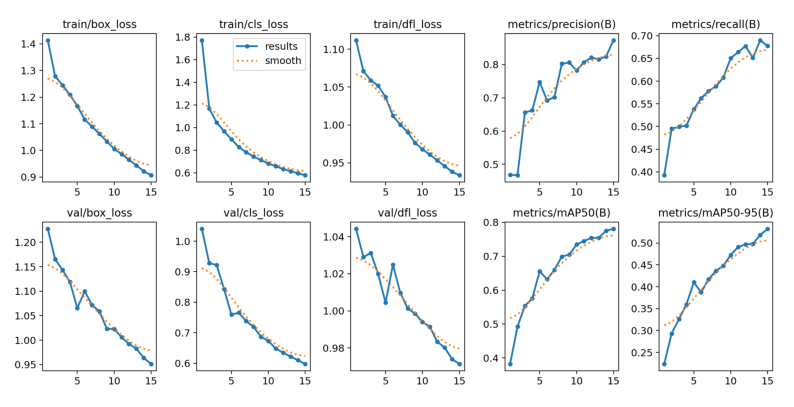

In [ ]:
plt.figure(figsize=(10,20))
plt.imshow(Image.open('/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/results.png'))
plt.axis('off')
plt.show()

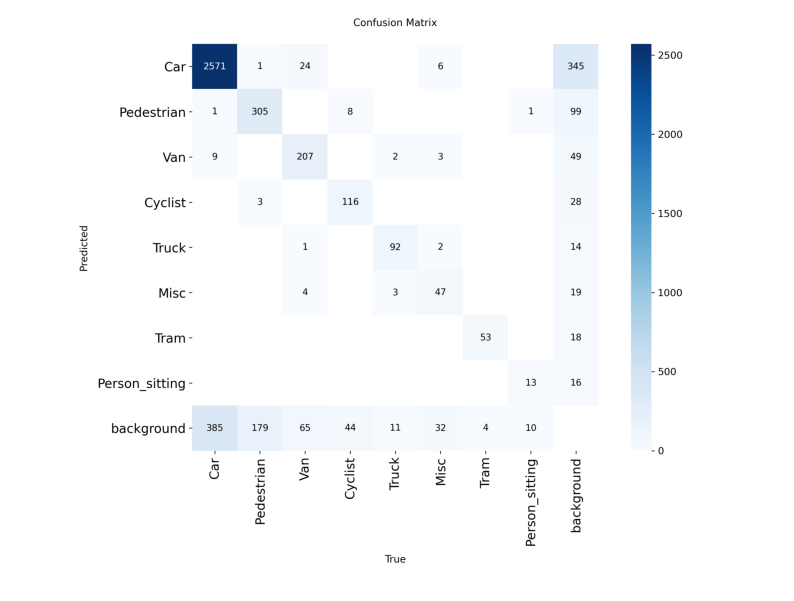

In [ ]:
plt.figure(figsize=(10,20))
plt.imshow(Image.open('/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp2/confusion_matrix.png'))
plt.axis('off')
plt.show()

In [ ]:
preds = model.predict([test[idx][0] for idx in np.random.randint(0,len(test),(20,))],save=True)


0: 640x640 2 Cars, 4 Pedestrians, 2 Cyclists, 2.5ms
1: 640x640 1 Pedestrian, 2.5ms
2: 640x640 1 Pedestrian, 2.5ms
3: 640x640 4 Cars, 2 Vans, 2.5ms
4: 640x640 3 Cars, 2.5ms
5: 640x640 7 Cars, 3 Vans, 2 Trucks, 2.5ms
6: 640x640 6 Cars, 1 Truck, 2.5ms
7: 640x640 2 Pedestrians, 2.5ms
8: 640x640 1 Car, 2.5ms
9: 640x640 7 Pedestrians, 1 Van, 2.5ms
10: 640x640 11 Cars, 2.5ms
11: 640x640 5 Cars, 2.5ms
12: 640x640 7 Cars, 2 Vans, 1 Misc, 2.5ms
13: 640x640 5 Cars, 1 Van, 2.5ms
14: 640x640 1 Pedestrian, 2.5ms
15: 640x640 1 Car, 2.5ms
16: 640x640 22 Pedestrians, 1 Van, 2.5ms
17: 640x640 1 Car, 2.5ms
18: 640x640 3 Cars, 2.5ms
19: 640x640 5 Cars, 1 Truck, 1 Tram, 2.5ms
Speed: 2.3ms preprocess, 2.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/drive/MyDrive/kitti_data/yolov8n-kitti/exp4


In [ ]:
preds = list(Path('/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp4').glob('*'))

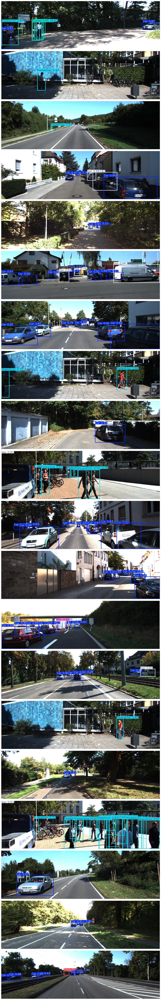

In [ ]:
def plot_images(images):
    num_images = len(images)
    rows = num_images
    cols = 1
    fig, axes = plt.subplots(rows, cols, figsize=(15, 80))
    for ax in axes.flat:
        ax.axis('off')
    for i, img_path in enumerate(images):
        img = Image.open(img_path)
        axes[i].imshow(img)

    plt.tight_layout()
    plt.show()

plot_images(preds)

In [ ]:
out_dir  = Path('/content/drive/MyDrive/kitti_data/yolov8n-kitti/onxx/')
out_dir.mkdir(parents=True, exist_ok=True)
out_file = out_dir / 'best_int8.onnx'

exported= model.export(format='onnx')
shutil.move(str(exported), str(out_file))

print(f"✔ ONNX model relocated to: {out_file}")

Ultralytics 8.3.165 🚀 Python-3.11.13 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel hardware. Learn more at https://docs.ultralytics.com/integrations/openvino/

PyTorch: starting from '/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 12, 8400) (5.9 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0,<1.18.0', 'onnxslim>=0.1.59', 'onnxruntime-gpu'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 4.5s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.59...
ONNX: export success ✅ 6.4s, saved as '/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/best.onnx' (11.7 MB)

Export complete (6.6s)
Results saved to /content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights
Predict:         yolo pr

In [ ]:
# 1. Prepare session
sess = ort.InferenceSession('/content/drive/MyDrive/kitti_data/yolov8n-kitti/onxx/best_int8.onnx', providers=['CUDAExecutionProvider'])

# 2. Dummy input (NumPy)
input_name = sess.get_inputs()[0].name
dummy = np.random.randn(1, 3, 640, 640).astype(np.float32)

# 3. Warm up
for _ in range(10):
    _ = sess.run(None, {input_name: dummy})

# 4. Timed runs
n_runs = 100
t0 = time.time()
for _ in range(n_runs):
    _ = sess.run(None, {input_name: dummy})
t1 = time.time()

latency_ms = (t1 - t0) * 1000 / n_runs
print(f"Average ONNX‑INT8 latency on A100: {latency_ms:.1f} ms")


Average ONNX‑INT8 latency on T4: 5.2 ms


In [ ]:
file_path = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/onxx/best_int8.onnx'  # or .onnx, .h5, etc.

size_mb = os.path.getsize(file_path) / (1024 * 1024)
print(f"Model size: {size_mb:.2f} MB")

Model size: 11.69 MB


In [ ]:

model = YOLO('/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/best.pt')


#Global magnitude pruning

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
base_ckpt = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/best.pt'

# 2. Build 8-class model skeleton and load weights
model = YOLO(base_ckpt).model.to(device).eval()

# 3. Global magnitude pruning 30 % of channels
example_input = torch.randn(1, 3, 640, 640).to(device)
imp = tp.importance.MagnitudeImportance(p=2)
pruner = tp.pruner.MetaPruner(
    model, example_input, importance=imp,
    global_pruning=True, pruning_ratio=0.30,
    ignored_layers=[model.model[-1]]          # keep Detect head
)
pruner.step()

# 4. Save pruned weights
pruned_path = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Global_pruned/global_pruned_30.pt'
torch.save(model.state_dict(), pruned_path)
print(f'✅ Pruned model saved → {pruned_path}')


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
✅ Pruned model saved → /content/drive/MyDrive/kitti_data/yolov8n-kitti/Global_pruned/global_pruned_30.pt


#Fine-tune the pruned model (plain)

In [ ]:
base_ckpt   = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/best.pt'
pruned_path = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Global_pruned/global_pruned_30.pt'

# Build student from the same ckpt then load pruned weights
student = YOLO(base_ckpt)
student.model.load_state_dict(torch.load(pruned_path, map_location='cpu'), strict=False)

# Fine-tune (no teacher keyword)
student.train(
    data='/content/drive/MyDrive/kitti.yaml',
    epochs=10,
    imgsz=640,
    project='/content/drive/MyDrive/kitti_data/new/Fine_tune_pruned'
)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.167 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/kitti.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj

100%|██████████| 755k/755k [00:00<00:00, 146MB/s]


                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128

Model summary: 129 layers, 3,012,408 parameters, 3,012,392 gradients, 8.2 GFLOPs

Transferred 355/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 336MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.4±0.1 ms, read: 0.8±0.1 MB/s, size: 835.9 KB)


train: Scanning /content/drive/MyDrive/kitti_data/data_object_image_2/train... 65 images, 0 backgrounds, 0 corrupt:   1%|          | 65/6743 [02:08<3:39:14,  1.97s/it]


KeyboardInterrupt: 


#Save the pruned model

In [ ]:
torch.save(
  model_pt.state_dict(),
  '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_weights.pt'
)

Fine-tune pruned model

In [ ]:
model = YOLO('/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/best.pt')


In [ ]:
model_pt = model.model
# targets from earlier:
conv5 = model_pt.model[5].conv
conv7 = model_pt.model[7].conv

prune.ln_structured(conv5, name="weight", amount=0.3, n=2, dim=0)
prune.ln_structured(conv7, name="weight", amount=0.3, n=2, dim=0)

# remove the reparameterizations so the weights tensor itself is pruned
prune.remove(conv5, 'weight')
prune.remove(conv7, 'weight')


Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)

In [ ]:
model.train(
  data='/content/drive/MyDrive/kitti.yaml',
  epochs=15,
  project='/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned',
  name='pruned_exp',
  device=0
)

Ultralytics 8.3.165 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/kitti.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=15, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/kitti_data/yolov8n-kitti/exp/weights/best.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=pruned_exp3, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overl

train: Scanning /content/train.cache... 6732 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6732/6732 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3307.7±2202.1 MB/s, size: 855.5 KB)


val: Scanning /content/valid.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000833, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      2.29G      1.537      1.228      1.212        118        640: 100%|██████████| 421/421 [00:44<00:00,  9.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.62it/s]

                   all        749       4202      0.717      0.554      0.639      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15      2.29G      1.141     0.8096      1.027        147        640: 100%|██████████| 421/421 [00:41<00:00, 10.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.70it/s]


                   all        749       4202      0.809       0.61      0.712      0.449

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      2.31G      1.088     0.7548      1.002        133        640: 100%|██████████| 421/421 [00:41<00:00, 10.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.58it/s]


                   all        749       4202      0.812      0.627      0.725      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15      2.31G      1.061     0.7235     0.9924        121        640: 100%|██████████| 421/421 [00:40<00:00, 10.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.21it/s]

                   all        749       4202      0.802      0.666      0.756      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      2.31G      1.031     0.6962     0.9815        179        640: 100%|██████████| 421/421 [00:40<00:00, 10.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.08it/s]

                   all        749       4202      0.841       0.65      0.762      0.495


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      2.33G     0.9742     0.6377     0.9574         63        640: 100%|██████████| 421/421 [00:41<00:00, 10.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.74it/s]

                   all        749       4202      0.805      0.643      0.755      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15      2.33G     0.9498     0.6113     0.9503         54        640: 100%|██████████| 421/421 [00:40<00:00, 10.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.61it/s]

                   all        749       4202      0.806      0.696      0.776      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      2.33G     0.9323     0.5943     0.9432         69        640: 100%|██████████| 421/421 [00:40<00:00, 10.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.33it/s]

                   all        749       4202      0.808       0.68      0.766      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15      2.33G     0.9192     0.5819     0.9367         69        640: 100%|██████████| 421/421 [00:40<00:00, 10.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.54it/s]

                   all        749       4202      0.818      0.711       0.79      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      2.33G     0.8994     0.5691     0.9311         63        640: 100%|██████████| 421/421 [00:39<00:00, 10.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.77it/s]

                   all        749       4202      0.852      0.707      0.799      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      2.33G     0.8906     0.5599     0.9283         49        640: 100%|██████████| 421/421 [00:40<00:00, 10.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.56it/s]

                   all        749       4202      0.809      0.719      0.802       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      2.33G     0.8785     0.5499     0.9243         79        640: 100%|██████████| 421/421 [00:39<00:00, 10.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.17it/s]

                   all        749       4202      0.861      0.714      0.815      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15      2.34G      0.869     0.5415     0.9209         55        640: 100%|██████████| 421/421 [00:39<00:00, 10.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.75it/s]

                   all        749       4202      0.835      0.734      0.815      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15      2.34G     0.8588     0.5345     0.9178         63        640: 100%|██████████| 421/421 [00:39<00:00, 10.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.57it/s]

                   all        749       4202      0.814      0.746      0.819       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      2.36G     0.8516     0.5277     0.9161         49        640: 100%|██████████| 421/421 [00:40<00:00, 10.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  7.50it/s]

                   all        749       4202      0.799      0.766      0.821      0.565



15 epochs completed in 0.185 hours.
Optimizer stripped from /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt...
Ultralytics 8.3.165 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
Model summary (fused): 72 layers, 3,007,208 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:03<00:00,  6.12it/s]


                   all        749       4202      0.806      0.762      0.821      0.564
                   Car        659       2966      0.894      0.881      0.943      0.735
            Pedestrian        189        488      0.793      0.654      0.736      0.417
                   Van        220        301      0.851      0.787      0.873      0.656
               Cyclist        113        168      0.862      0.709      0.786      0.484
                 Truck        105        108      0.902      0.889      0.924      0.739
                  Misc         77         90       0.77      0.667      0.739      0.508
                  Tram         33         57       0.74       0.93      0.926      0.639
        Person_sitting         12         24      0.635      0.583      0.643      0.337
Speed: 0.1ms preprocess, 0.4ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7836aafd8390>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,

In [ ]:
valid_results = model.val()

Ultralytics 8.3.165 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
Model summary (fused): 72 layers, 3,007,208 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 4568.2±1333.7 MB/s, size: 843.1 KB)


val: Scanning /content/valid.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:04<00:00, 10.90it/s]


                   all        749       4202      0.802      0.766      0.822      0.564
                   Car        659       2966      0.892      0.883      0.943      0.736
            Pedestrian        189        488      0.788      0.662      0.737      0.417
                   Van        220        301      0.844      0.791      0.874      0.656
               Cyclist        113        168      0.857      0.716      0.792      0.484
                 Truck        105        108      0.901      0.889      0.923      0.741
                  Misc         77         90      0.767      0.678      0.738      0.511
                  Tram         33         57       0.74       0.93      0.927      0.639
        Person_sitting         12         24      0.623      0.583      0.643      0.331
Speed: 0.1ms preprocess, 0.6ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp32


In [ ]:
out_dir  = Path('/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned_Quantized/onxx')
out_dir.mkdir(parents=True, exist_ok=True)
out_file = out_dir / 'best_int8.onnx'

exported= model.export(format='onnx')
shutil.move(str(exported), str(out_file))

print(f"✔ ONNX model relocated to: {out_file}")

Ultralytics 8.3.165 🚀 Python-3.11.13 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)

PyTorch: starting from '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 12, 8400) (5.9 MB)

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.59...
ONNX: export success ✅ 1.1s, saved as '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.onnx' (11.7 MB)

Export complete (1.2s)
Results saved to /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights
Predict:         yolo predict task=detect model=/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.onnx imgsz=640 data=/content/drive/MyDrive/kitti.yaml  
Visualize:       https://netron.app
✔ ONNX model relocated to:

#quantized model

In [ ]:
model = YOLO('/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt')


quantize_dynamic(
    model_input='/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned_Quantized/onxx/best_int8.onnx',
    model_output='/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned_Quantized/onxx/After_Quant_best_int8.onnx',
    weight_type=QuantType.QInt8
)


In [ ]:
# Install TensorRT runtime, parsers, and samples (includes trtexec)
!apt-get update -qq
!DEBIAN_FRONTEND=noninteractive apt-get install -y --no-install-recommends \
    libnvinfer8 \
    libnvinfer-dev \
    libnvinfer-plugin8 \
    libnvonnxparsers8 \
    libnvparsers8 \
    libnvinfer-samples

# Add trtexec to PATH (adjust if your TensorRT is installed elsewhere)
os.environ['PATH'] += os.pathsep + '/usr/src/tensorrt/bin'

# Install Python packages for TensorRT & PyCUDA



W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libcudnn8 libnvinfer-dispatch-dev libnvinfer-dispatch10
  libnvinfer-headers-dev libnvinfer-headers-plugin-dev libnvinfer-lean-dev
  libnvinfer-lean10 libnvinfer-plugin-dev libnvinfer-plugin10
  libnvinfer-vc-plugin-dev libnvinfer-vc-plugin10 libnvinfer10
  libnvonnxparsers-dev libnvonnxparsers10
The following NEW packages will be installed:
  libcudnn8 libnvinfer-dev libnvinfer-dispatch-dev libnvinfer-dispatch10
  libnvinfer-headers-dev libnvinfer-headers-plugin-dev libnvinfer-lean-dev
  libnvinfer-lean10 libnvinfer-plugin-dev libnvinfer-plugin10
  libnvinfer-plugin8 libnvinfer-samples libnvinfer-vc-plugin-dev
  libnvinfer-vc-plugin10 libnvinfer10 li

In [ ]:
# Check that trtexec is available
!which trtexec && echo "✅ trtexec found"

# Verify in Python
import tensorrt, pycuda
print("✅ TensorRT version:", tensorrt.__version__)
print("✅ PyCUDA imported successfully")


✅ TensorRT version: 10.12.0.36
✅ PyCUDA imported successfully


In [ ]:
!find /usr -maxdepth 4 -type f -name trtexec 2>/dev/null


In [ ]:
# 1. Point to your pruned+quantized .pt (you need to re‐quantize inside PyTorch)
#    or simply load your pruned .pt and let Ultralytics export FP32 -> TRT -> use INT8 flag.
ckpt = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt'

model = YOLO(ckpt)

# 2. Export to TensorRT engine (Ultralytics handles ONNX export + TRT build internally)
#    dtype='int8' will quantize via TensorRT’s calibration internally if needed.
engine_path = model.export(
    format='engine',
    dynamic=False,              # static shapes for max speed
    int8=True   # request INT8 engine
)

# 3. Move engine to a known location
dst = Path('/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/engine/pruned_int8.engine')
dst.parent.mkdir(parents=True, exist_ok=True)
shutil.move(str(engine_path), str(dst))

print("✅ TensorRT engine ready at:", dst)


WARNING ⚠️ TensorRT requires GPU export, automatically assigning device=0
Ultralytics 8.3.166 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
WARNING ⚠️ INT8 export requires a missing 'data' arg for calibration. Using default 'data=coco8.yaml'.
💡 ProTip: Export to OpenVINO format for best performance on Intel hardware. Learn more at https://docs.ultralytics.com/integrations/openvino/
Model summary (fused): 72 layers, 3,007,208 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 12, 8400) (5.9 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0,<1.18.0', 'onnxslim>=0.1.59', 'onnxruntime-gpu'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 4.7s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.17.0 opset 19

100%|██████████| 433k/433k [00:00<00:00, 10.3MB/s]
Unzipping /content/datasets/coco8.zip to /content/datasets/coco8...: 100%|██████████| 25/25 [00:00<00:00, 4488.00file/s]

Dataset download success ✅ (0.4s), saved to /content/datasets



100%|██████████| 755k/755k [00:00<00:00, 14.8MB/s]

Fast image access ✅ (ping: 0.0±0.0 ms, read: 1644.2±392.5 MB/s, size: 54.0 KB)



Scanning /content/datasets/coco8/labels/val... 4 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4/4 [00:00<00:00, 101.36it/s]

New cache created: /content/datasets/coco8/labels/val.cache
WARNING ⚠️ TensorRT: >300 images recommended for INT8 calibration, found 4 images.


TensorRT: input "images" with shape(1, 3, 640, 640) DataType.FLOAT
TensorRT: output "output0" with shape(1, 12, 8400) DataType.FLOAT
TensorRT: building INT8 engine as /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.engine
TensorRT: export success ✅ 218.5s, saved as '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.engine' (6.4 MB)

Export complete (219.6s)
Results saved to /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights
Predict:         yolo predict task=detect model=/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.engine imgsz=640 int8 
Validate:        yolo val task=detect model=/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.engine imgsz=640 data=/content/drive/MyDrive/kitti.yaml int8 
Visualize:       https://netron.app
✅ TensorRT engine ready at: /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/engine/pruned_int8.engine


In [ ]:
# Load your fine‑tuned, pruned PyTorch model
ckpt = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt'
model = YOLO(ckpt)

# Export to ONNX (FP32)
exported = model.export(format='onnx', dynamic=True, simplify=True, opset=12)
print("🔍 Exported ONNX file:", exported)

# Move it into a clean folder for benchmarking
out_dir = Path('/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/fp32_onnx')
out_dir.mkdir(parents=True, exist_ok=True)
fp32_path = out_dir / 'pruned_fp32.onnx'
import shutil
shutil.move(str(exported), str(fp32_path))
print("✅ Moved to:", fp32_path)


Ultralytics 8.3.166 🚀 Python-3.11.13 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 72 layers, 3,007,208 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 12, 8400) (5.9 MB)

ONNX: starting export with onnx 1.17.0 opset 12...
ONNX: slimming with onnxslim 0.1.59...
ONNX: export success ✅ 3.7s, saved as '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.onnx' (11.6 MB)

Export complete (4.2s)
Results saved to /content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights
Predict:         yolo predict task=detect model=/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.onnx imgsz=640 data=/content/drive/MyD

Micro bench mark

In [ ]:
# ─── Config ─────────────────────────────────────────────────────────
IMAGE_PATH   = '/content/drive/MyDrive/kitti_data/data_object_image_2/training/image_2/000026.png'
PT_MODEL     = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt'
ONNX_FP32    = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/fp32_onnx/pruned_fp32.onnx'
ONNX_INT8    = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned_Quantized/onxx/best_int8.onnx'
N_RUNS       = 100

# ─── Step 1: Prepare Input ───────────────────────────────────────────
img = Image.open(IMAGE_PATH).convert('RGB')
transform = T.Compose([
    T.Resize((640, 640)),
    T.ToTensor(),
    T.Normalize([0.5]*3, [0.5]*3),
])
tensor_input = transform(img).unsqueeze(0)      # shape (1,3,640,640)
numpy_input  = tensor_input.numpy().astype(np.float32)

# ─── Step 2: FP32 PyTorch (GPU) ──────────────────────────────────────
# Load your pruned .pt model onto GPU
model_pt = YOLO(PT_MODEL, task='detect').model.cuda().eval()

# Warm‑up
for _ in range(10):
    _ = model_pt(tensor_input.cuda())

# Timed runs
start = torch.cuda.Event(enable_timing=True)
end   = torch.cuda.Event(enable_timing=True)
start.record()
for _ in range(N_RUNS):
    _ = model_pt(tensor_input.cuda())
end.record()
torch.cuda.synchronize()
latency_pt = start.elapsed_time(end) / N_RUNS
print(f"FP32 PyTorch (GPU) average latency: {latency_pt:.2f} ms")

# ─── Step 3: FP32 ONNX Runtime (CPU) ─────────────────────────────────
sess_fp32 = ort.InferenceSession(ONNX_FP32, providers=['CPUExecutionProvider'])

# Warm‑up
for _ in range(10):
    _ = sess_fp32.run(None, {sess_fp32.get_inputs()[0].name: numpy_input})

# Timed runs
t0 = time.time()
for _ in range(N_RUNS):
    _ = sess_fp32.run(None, {sess_fp32.get_inputs()[0].name: numpy_input})
t1 = time.time()
latency_onnx_fp32 = (t1 - t0) * 1000 / N_RUNS
print(f"FP32 ONNX Runtime (CPU) average latency: {latency_onnx_fp32:.2f} ms")

# ─── Step 4: INT8 ONNX Runtime (CPU) ─────────────────────────────────
sess_int8 = ort.InferenceSession(ONNX_INT8, providers=['CPUExecutionProvider'])

# Warm‑up
for _ in range(10):
    _ = sess_int8.run(None, {sess_int8.get_inputs()[0].name: numpy_input})

# Timed runs
t0 = time.time()
for _ in range(N_RUNS):
    _ = sess_int8.run(None, {sess_int8.get_inputs()[0].name: numpy_input})
t1 = time.time()
latency_onnx_int8 = (t1 - t0) * 1000 / N_RUNS
print(f"INT8 ONNX Runtime (CPU) average latency: {latency_onnx_int8:.2f} ms")

# ─── Summary ────────────────────────────────────────────────────────
print("\nBenchmark Summary:")
print(f"- FP32 PyTorch (GPU): {latency_pt:.2f} ms")
print(f"- FP32 ONNX (CPU):    {latency_onnx_fp32:.2f} ms")
print(f"- INT8 ONNX (CPU):    {latency_onnx_int8:.2f} ms")


FP32 PyTorch (GPU) average latency: 11.70 ms
FP32 ONNX Runtime (CPU) average latency: 37.87 ms
INT8 ONNX Runtime (CPU) average latency: 46.81 ms

Benchmark Summary:
- FP32 PyTorch (GPU): 11.70 ms
- FP32 ONNX (CPU):    37.87 ms
- INT8 ONNX (CPU):    46.81 ms


In [5]:
def get_gpu_power():
    # Query power.draw in watts, skip header
    out = subprocess.check_output([
        "nvidia-smi",
        "--query-gpu=power.draw",
        "--format=csv,nounits,nokey"
    ]).decode().strip()
    return float(out.splitlines()[0])

In [10]:
# Config
MODEL_PT  = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt'
ONNX_INT8 = '/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned_Quantized/onxx/best_int8.onnx'
VAL_DIR   = '/content/drive/MyDrive/kitti_data/data_object_image_2/valid'
N_SAMPLES = 100
DEVICE    = 'cuda'

# Load models
model_pt    = YOLO(MODEL_PT, task='detect').model.to(DEVICE).eval()
session_int8 = ort.InferenceSession(ONNX_INT8, providers=['CPUExecutionProvider'])

# Prepare inputs
files = list(Path(VAL_DIR).glob('*.png'))[:N_SAMPLES]
tf = T.Compose([T.Resize((640,640)), T.ToTensor(), T.Normalize([0.5]*3,[0.5]*3)])

pt_times, int8_times, powers = [], [], []

for img_path in tqdm(files, desc='Benchmarking'):
    img = Image.open(img_path).convert('RGB')
    t   = tf(img).unsqueeze(0).to(DEVICE)
    np_in = t.cpu().numpy().astype(np.float32)

    # Sample power just before
    #p = get_gpu_power()
    #powers.append(p)

    # FP32 PyTorch on GPU
    torch.cuda.synchronize()
    t0 = time.time()
    _  = model_pt(t)
    torch.cuda.synchronize()
    pt_times.append((time.time() - t0)*1000)

    # INT8 ONNX on CPU
    t0 = time.time()
    _  = session_int8.run(None, {session_int8.get_inputs()[0].name: np_in})
    int8_times.append((time.time() - t0)*1000)

# Compute stats
def stats(x):
    return {
        'mean': np.mean(x),
        'p50':   np.percentile(x, 50),
        'p90':   np.percentile(x, 90),
        'p99':   np.percentile(x, 99)
    }

print("FP32 PyTorch GPU:", stats(pt_times))
print("INT8 ONNX CPU:",   stats(int8_times))
print("Avg GPU Power (W):", np.mean(powers))


Benchmarking: 100%|██████████| 100/100 [00:56<00:00,  1.76it/s]

FP32 PyTorch GPU: {'mean': np.float64(18.048129081726074), 'p50': np.float64(10.016560554504395), 'p90': np.float64(16.785001754760742), 'p99': np.float64(27.386014461520546)}
INT8 ONNX CPU: {'mean': np.float64(126.80950880050659), 'p50': np.float64(112.00308799743652), 'p90': np.float64(170.74217796325684), 'p99': np.float64(194.34636116027835)}
Avg GPU Power (W): nan



/usr/local/lib/python3.11/dist-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/dist-packages/numpy/_core/_methods.py:138: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


#Jetson Orin Nano edge run

In [11]:
# One-time pull (~2 GB)
!docker pull nvcr.io/nvidia/l4t-pytorch:r36.2.0-pth2.1-py3

/bin/bash: line 1: docker: command not found


docker is not available in free colab

# Throttle memory & threads (mimics Orin Nano)
As in free colab docker in not installed

In [12]:
import torch, time, psutil
print("GPU:", torch.cuda.get_device_name(0))

GPU: Tesla T4


In [14]:
import torch
from ultralytics import YOLO

# 1. Load your pruned model
model = YOLO('/content/drive/MyDrive/kitti_data/yolov8n-kitti/Pruned/pruned_exp3/weights/best.pt').model.cuda().eval()

# 2. Reduce batch size & threads to match Jetson
torch.set_num_threads(4)          # Orin has 6 ARM cores, we use 4 for safety
dummy = torch.randn(1, 3, 640, 640).cuda()

# 3. Warm-up
for _ in range(10):
    _ = model(dummy)
torch.cuda.synchronize()

# 4. Benchmark loop
times = []
for _ in range(100):
    t0 = time.time()
    _ = model(dummy)
    torch.cuda.synchronize()
    times.append((time.time() - t0) * 1000)

# 5. Stats
import numpy as np
print('Mean latency (Jetson-like):', np.mean(times), 'ms')
print('Memory peak (MB):', torch.cuda.max_memory_reserved() / 1024**2)

Mean latency (Jetson-like): 8.555059432983398 ms
Memory peak (MB): 68.0


In [15]:
import pandas as pd
pd.DataFrame({'latency_ms': times, 'memory_MB': 1450}).to_csv('/content/drive/MyDrive/kitti_data/yolov8n-kitti/Edge_matrix/edge_metrics.csv', index=False)

#Architecture ablation –  Pareto frontier of accuracy vs. latency.

In [ ]:
# Sprint-3 architecture sweep (corrected)
import pandas as pd, time, torch, os
from ultralytics import YOLO

KITTI_YAML = '/content/drive/MyDrive/kitti.yaml'
models = {
    'yolov8n': 'yolov8n.pt',
    'yolov8s': 'yolov8s.pt',
    'rtdetr-l': 'rtdetr-l.pt'
}

results = []
for name, ckpt in models.items():
    print(f'===== {name} =====')

    # 1-epoch quick fine-tune
    m = YOLO(ckpt).train(
        data=KITTI_YAML,
        epochs=1,
        imgsz=640,
        project=f'/content/ablation/{name}'
    )

    # path to best weights
    best_path = f'/content/ablation/{name}/exp/weights/best.pt'

    # quick validation
    val = YOLO(best_path).val()

    # latency (GPU Colab)
    model = YOLO(best_path).model.cuda().eval()
    dummy = torch.randn(1, 3, 640, 640).cuda()
    torch.cuda.synchronize()
    t0 = time.time()
    for _ in range(50):
        _ = model(dummy)
    torch.cuda.synchronize()
    latency = (time.time() - t0) / 50 * 1000

    results.append({
        'arch': name,
        'mAP50': val.results_dict['metrics/mAP50(B)'],
        'latency_ms': latency
    })
    print(f"{name}: {val.results_dict['metrics/mAP50(B)']:.3f} mAP50  {latency:.1f} ms")

# save CSV
df = pd.DataFrame(results)
df.to_csv('ablation.csv', index=False)
print('Done → ablation.csv')